In [ ]:
import cv2
import os
import re
import numpy as np
import pandas as pd
from moviepy.editor import VideoFileClip

import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
video_df = pd.read_csv('/data/mskscratch/users/ghoyer/Precision_Air/air_loc_processed_vid_details_0424.csv')

video_df

,Video_ID,Video_path,Video_ext,Santiago_Review,Sean_Review,Santiago_Total_time_of_attempt,Sean_Total_time_of_attempt,Santiago_Total_time_of_tracheal_access,Sean_Total_time_of_tracheal_access,Santiago_new_blood_erythema,...,FPS,Width,Height,Frame_Count,Processed_video_path,Processed_Duration_sec,Processed_FPS,Processed_Width,Processed_Height,Processed_Frame_Count
0,20201029-170946,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2b,2,24.0,15,17.0,7,NaN,...,15.0,640.0,480.0,4073.0,/data/mskscratch/users/ghoyer/Precision_Air/te...,22.73,15.0,640,480,341
1,20201026-094437,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,1,1,16.0,6,10.0,3,NaN,...,15.0,640.0,480.0,2888.0,/data/mskscratch/users/ghoyer/Precision_Air/te...,7.73,15.0,640,480,116
2,20201011-041330,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2b,2,24.0,11,17.0,5,NaN,...,15.0,640.0,480.0,1193.0,/data/mskscratch/users/ghoyer/Precision_Air/te...,12.00,15.0,640,480,181
3,20201019-154106,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2b,2,43.0,16,33.0,10,NaN,...,15.0,640.0,480.0,1930.0,/data/mskscratch/users/ghoyer/Precision_Air/te...,16.47,15.0,640,480,248
4,20201016-124433,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2d,2,17.0,10,13.0,4,NaN,...,15.0,640.0,480.0,3007.0,/data/mskscratch/users/ghoyer/Precision_Air/te...,11.13,15.0,640,480,167
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,20200606_053830,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.mp4,2,2,17.0,21,11.0,11,N,...,30.0,640.0,480.0,1006.0,/data/mskscratch/users/ghoyer/Precision_Air/te...,24.30,30.0,640,480,730
95,20200229-212409,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,1,1,8.0,5,4.0,2,N,...,15.0,640.0,480.0,2804.0,/data/mskscratch/users/ghoyer/Precision_Air/te...,6.47,15.0,640,480,98
96,20200326-060122,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,3,3,35.0,13,15.0,4,Y,...,15.0,640.0,480.0,878.0,/data/mskscratch/users/ghoyer/Precision_Air/te...,14.00,15.0,640,480,211
97,20200517-223211,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2,2,31.0,11,16.0,5,N,...,NaN,NaN,NaN,NaN,/data/mskscratch/users/ghoyer/Precision_Air/te...,12.93,15.0,640,480,194


In [3]:
video_df.columns.to_list()


['Video_ID',
 'Video_path',
 'Video_ext',
 'Santiago_Review',
 'Sean_Review',
 'Santiago_Total_time_of_attempt',
 'Sean_Total_time_of_attempt',
 'Santiago_Total_time_of_tracheal_access',
 'Sean_Total_time_of_tracheal_access',
 'Santiago_new_blood_erythema',
 'Sean_new_blood_erythema',
 'Santiago_Best_CL_grade',
 'Sean_Best_CL_grade',
 'Duration_sec',
 'FPS',
 'Width',
 'Height',
 'Frame_Count',
 'Processed_video_path',
 'Processed_Duration_sec',
 'Processed_FPS',
 'Processed_Width',
 'Processed_Height',
 'Processed_Frame_Count']

In [ ]:

def list_unique_values(df, columns):
    """
    List unique values for specified columns in the dataframe.
    
    Args:
        df (pandas.DataFrame): Input dataframe
        columns (list): List of column names to analyze
    
    Returns:
        dict: Dictionary with column names as keys and lists of unique values as values
    """
    unique_values = {}
    
    for col in columns:
        # Get unique values, including NaN if present
        values = df[col].dropna().unique().tolist()
        unique_values[col] = values
        # Print unique values for the column
        print(f"\nUnique values in '{col}':")
        if values:
            for val in sorted(values, key=lambda x: str(x)):  # Sort for readability
                print(f"  - {val}")
        else:
            print("  (No non-null values)")
    
    return unique_values

# Example usage:
columns_to_analyze = [
    'Santiago_Review',
    'Sean_Review',
    'Santiago_Total_time_of_attempt',
    'Sean_Total_time_of_attempt',
    'Santiago_Total_time_of_tracheal_access',
    'Sean_Total_time_of_tracheal_access',
    'Santiago_new_blood_erythema',
    'Sean_new_blood_erythema',
    'Santiago_Best_CL_grade',
    'Sean_Best_CL_grade'
]

# video_df = pd.read_csv('your_data.csv')  # Load your dataframe
unique_values = list_unique_values(video_df, columns_to_analyze)

print(unique_values)


Unique values in 'Santiago_Review':
  - 1
  - 2
  - 2b
  - 2c
  - 2d
  - 3
  - 3b
  - 4b

Unique values in 'Sean_Review':
  - 1
  - 2
  - 2b
  - 2c
  - 3
  - 3b
  - 3c
  - 4b
  - x

Unique values in 'Santiago_Total_time_of_attempt':
  - 10.0
  - 11.0
  - 12.0
  - 13.0
  - 14.0
  - 15.0
  - 16.0
  - 17.0
  - 18.0
  - 19.0
  - 20.0
  - 21.0
  - 22.0
  - 23.0
  - 24.0
  - 25.0
  - 27.0
  - 30.0
  - 31.0
  - 32.0
  - 33.0
  - 34.0
  - 35.0
  - 36.0
  - 37.0
  - 38.0
  - 39.0
  - 40.0
  - 42.0
  - 43.0
  - 44.0
  - 46.0
  - 47.0
  - 48.0
  - 49.0
  - 51.0
  - 54.0
  - 57.0
  - 61.0
  - 62.0
  - 63.0
  - 7.0
  - 75.0
  - 8.0
  - 88.0
  - 9.0

Unique values in 'Sean_Total_time_of_attempt':
  - 10
  - 11
  - 12
  - 13
  - 139
  - 14
  - 15
  - 16
  - 17
  - 18
  - 19
  - 20
  - 21
  - 23
  - 24
  - 25
  - 26
  - 29
  - 3
  - 32
  - 35
  - 37
  - 38
  - 4
  - 40
  - 42
  - 48
  - 49
  - 5
  - 57
  - 6
  - 7
  - 8
  - 9
  - 90+ secs

Unique values in 'Santiago_Total_time_of_tracheal_access':
  

### Standardize graded columns for time and categorical classifications 

In [ ]:

def standardize_time_columns(df, columns):
    """
    Standardize time-based columns to float values, handling binned and inconsistent formats.
    
    Args:
        df (pandas.DataFrame): Input dataframe
        columns (list): List of column names to standardize
    
    Returns:
        pandas.DataFrame: Dataframe with new standardized columns
    """
    # Dictionary to store problematic values for logging
    problematic_values = {col: [] for col in columns}
    
    # Create new standardized columns
    for col in columns:
        new_col = f"{col}_std"
        df[new_col] = pd.Series(dtype=float)
        
        for idx, value in df[col].items():
            if pd.isna(value):
                df.at[idx, new_col] = None
                continue
                
            # Convert value to string to handle mixed types
            value_str = str(value).strip().lower()
            
            # Handle binned values like '90+ secs' or '60+ Secs'
            if '+' in value_str:
                # Extract numeric part (e.g., '90' from '90+ secs')
                match = re.match(r'(\d+)', value_str)
                if match:
                    df.at[idx, new_col] = float(match.group(1))
                else:
                    df.at[idx, new_col] = None
                    problematic_values[col].append((idx, value))
            else:
                # Try converting to float
                try:
                    df.at[idx, new_col] = float(value_str)
                except ValueError:
                    df.at[idx, new_col] = None
                    problematic_values[col].append((idx, value))
    
    # Log problematic values
    for col, issues in problematic_values.items():
        if issues:
            print(f"\nProblematic values in '{col}':")
            for idx, val in issues:
                print(f"  - Index {idx}: {val}")
    
    return df

# Example usage:
time_columns = [
    'Santiago_Total_time_of_attempt',
    'Sean_Total_time_of_attempt',
    'Santiago_Total_time_of_tracheal_access',
    'Sean_Total_time_of_tracheal_access'
]

# video_df = pd.read_csv('your_data.csv')  # Load your dataframe
video_df = standardize_time_columns(video_df, time_columns)
# video_df.to_csv('standardized_data.csv', index=False)  # Save the updated dataframe

In [ ]:

def standardize_cl_grade_columns(df, columns):
    """
    Standardize Best_CL_grade columns into numerical + subgrade and numeral-only formats.
    Replace Roman numerals (I, II) with Arabic numerals (1, 2).
    
    Args:
        df (pandas.DataFrame): Input dataframe
        columns (list): List of column names to standardize
    
    Returns:
        pandas.DataFrame: Dataframe with new standardized columns
    """
    # Mapping dictionaries
    santiago_subgrade_map = {
        'I': '1',
        'IIa': '2a',
        'IIb': '2b',
        'i': '1',
        'iia': '2a',
        'iib': '2b'
    }
    
    sean_subgrade_map = {
        '1': '1',
        '2': '2',    # Ambiguous, logged for review
        '2a': '2a',
        '2b': '2b'
    }
    
    santiago_num_map = {
        'I': '1',
        'IIa': '2',
        'IIb': '2',
        'i': '1',
        'iia': '2',
        'iib': '2'
    }
    
    sean_num_map = {
        '1': '1',
        '2': '2',
        '2a': '2',
        '2b': '2'
    }
    
    # Dictionary to store problematic values
    problematic_values = {col: [] for col in columns}
    
    # Process each column
    for col in columns:
        # Create two new columns: subgrade and numeral-only
        subgrade_col = f"{col}_std"
        num_col = f"{col}_num"
        df[subgrade_col] = pd.Series(dtype=str)
        df[num_col] = pd.Series(dtype=str)
        
        # Select appropriate mappings
        subgrade_map = santiago_subgrade_map if 'Santiago' in col else sean_subgrade_map
        num_map = santiago_num_map if 'Santiago' in col else sean_num_map
        
        for idx, value in df[col].items():
            if pd.isna(value):
                df.at[idx, subgrade_col] = None
                df.at[idx, num_col] = None
                continue
                
            # Convert to string and handle case
            value_str = str(value).strip().lower()
            
            # Map to subgrade format
            if value_str in subgrade_map:
                df.at[idx, subgrade_col] = subgrade_map[value_str]
                # Log ambiguous '2' in Sean's column
                if col == 'Sean_Best_CL_grade' and value_str == '2':
                    problematic_values[col].append((idx, value))
            else:
                df.at[idx, subgrade_col] = None
                problematic_values[col].append((idx, value))
            
            # Map to numeral-only format
            if value_str in num_map:
                df.at[idx, num_col] = num_map[value_str]
            else:
                df.at[idx, num_col] = None
                problematic_values[col].append((idx, value))
    
    # Log problematic values
    for col, issues in problematic_values.items():
        if issues:
            print(f"\nProblematic or ambiguous values in '{col}':")
            for idx, val in issues:
                print(f"  - Index {idx}: {val}")
    
    return df

# Example usage:
cl_grade_columns = [
    'Santiago_Best_CL_grade',
    'Sean_Best_CL_grade'
]

# video_df = pd.read_csv('your_data.csv')  # Load your dataframe
video_df = standardize_cl_grade_columns(video_df, cl_grade_columns)
# video_df.to_csv('standardized_data.csv', index=False)  # Save the updated dataframe


Problematic or ambiguous values in 'Sean_Best_CL_grade':
  - Index 2: 2
  - Index 4: 2
  - Index 6: 2
  - Index 8: 2
  - Index 14: 2
  - Index 18: 2
  - Index 22: 2
  - Index 23: 2
  - Index 29: 2
  - Index 33: 2
  - Index 34: 2
  - Index 35: 2
  - Index 38: 2
  - Index 39: 2
  - Index 49: 2
  - Index 59: 2
  - Index 60: 2
  - Index 61: 2
  - Index 62: 2
  - Index 63: 2
  - Index 66: 2
  - Index 79: 2
  - Index 81: 2
  - Index 86: 2
  - Index 87: 2
  - Index 94: 2


In [8]:
video_df

,Video_ID,Video_path,Video_ext,Santiago_Review,Sean_Review,Santiago_Total_time_of_attempt,Sean_Total_time_of_attempt,Santiago_Total_time_of_tracheal_access,Sean_Total_time_of_tracheal_access,Santiago_new_blood_erythema,...,Processed_Height,Processed_Frame_Count,Santiago_Total_time_of_attempt_std,Sean_Total_time_of_attempt_std,Santiago_Total_time_of_tracheal_access_std,Sean_Total_time_of_tracheal_access_std,Santiago_Best_CL_grade_std,Santiago_Best_CL_grade_num,Sean_Best_CL_grade_std,Sean_Best_CL_grade_num
0,20201029-170946,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2b,2,24.0,15,17.0,7,NaN,...,480,341,24.0,15.0,17.0,7.0,1,1,1,1
1,20201026-094437,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,1,1,16.0,6,10.0,3,NaN,...,480,116,16.0,6.0,10.0,3.0,1,1,1,1
2,20201011-041330,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2b,2,24.0,11,17.0,5,NaN,...,480,181,24.0,11.0,17.0,5.0,2a,2,2,2
3,20201019-154106,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2b,2,43.0,16,33.0,10,NaN,...,480,248,43.0,16.0,33.0,10.0,1,1,1,1
4,20201016-124433,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2d,2,17.0,10,13.0,4,NaN,...,480,167,17.0,10.0,13.0,4.0,1,1,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,20200606_053830,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.mp4,2,2,17.0,21,11.0,11,N,...,480,730,17.0,21.0,11.0,11.0,2a,2,2,2
95,20200229-212409,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,1,1,8.0,5,4.0,2,N,...,480,98,8.0,5.0,4.0,2.0,1,1,1,1
96,20200326-060122,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,3,3,35.0,13,15.0,4,Y,...,480,211,35.0,13.0,15.0,4.0,2a,2,1,1
97,20200517-223211,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2,2,31.0,11,16.0,5,N,...,480,194,31.0,11.0,16.0,5.0,1,1,1,1


In [9]:
video_df.columns.to_list()

['Video_ID',
 'Video_path',
 'Video_ext',
 'Santiago_Review',
 'Sean_Review',
 'Santiago_Total_time_of_attempt',
 'Sean_Total_time_of_attempt',
 'Santiago_Total_time_of_tracheal_access',
 'Sean_Total_time_of_tracheal_access',
 'Santiago_new_blood_erythema',
 'Sean_new_blood_erythema',
 'Santiago_Best_CL_grade',
 'Sean_Best_CL_grade',
 'Duration_sec',
 'FPS',
 'Width',
 'Height',
 'Frame_Count',
 'Processed_video_path',
 'Processed_Duration_sec',
 'Processed_FPS',
 'Processed_Width',
 'Processed_Height',
 'Processed_Frame_Count',
 'Santiago_Total_time_of_attempt_std',
 'Sean_Total_time_of_attempt_std',
 'Santiago_Total_time_of_tracheal_access_std',
 'Sean_Total_time_of_tracheal_access_std',
 'Santiago_Best_CL_grade_std',
 'Santiago_Best_CL_grade_num',
 'Sean_Best_CL_grade_std',
 'Sean_Best_CL_grade_num']

In [10]:
columns_to_analyze2 = [
 'Santiago_Best_CL_grade_std',
 'Santiago_Best_CL_grade_num',
 'Sean_Best_CL_grade_std',
 'Sean_Best_CL_grade_num'
]

# video_df = pd.read_csv('your_data.csv')  # Load your dataframe
unique_values2 = list_unique_values(video_df, columns_to_analyze2)
print(unique_values2)



Unique values in 'Santiago_Best_CL_grade_std':
  - 1
  - 2a
  - 2b

Unique values in 'Santiago_Best_CL_grade_num':
  - 1
  - 2

Unique values in 'Sean_Best_CL_grade_std':
  - 1
  - 2
  - 2a
  - 2b

Unique values in 'Sean_Best_CL_grade_num':
  - 1
  - 2
{'Santiago_Best_CL_grade_std': ['1', '2a', '2b'], 'Santiago_Best_CL_grade_num': ['1', '2'], 'Sean_Best_CL_grade_std': ['1', '2', '2b', '2a'], 'Sean_Best_CL_grade_num': ['1', '2']}


In [ ]:

def standardize_blood_erythema_columns(df, columns):
    """
    Standardize new_blood_erythema columns to unified format ('Y', 'N', '1', '??').
    Handle capitalization and extra values in Sean's column.
    
    Args:
        df (pandas.DataFrame): Input dataframe
        columns (list): List of column names to standardize
    
    Returns:
        pandas.DataFrame: Dataframe with new standardized columns
    """
    # Mapping dictionary
    erythema_map = {
        'y': 'Y',
        'n': 'N',
        '1': '1',              # Ambiguous, preserved and logged
        '??': '??',            # Uncertainty, preserved and logged
        'i dont see it': 'N',  # Mapped to N, logged for review
        'i don\'t see it': 'N' # Handle alternative apostrophe
    }
    
    # Dictionary to store problematic/ambiguous values
    problematic_values = {col: [] for col in columns}
    
    # Process each column
    for col in columns:
        new_col = f"{col}_std"
        df[new_col] = pd.Series(dtype=str)
        
        for idx, value in df[col].items():
            if pd.isna(value):
                df.at[idx, new_col] = None
                continue
                
            # Convert to string and handle case
            value_str = str(value).strip().lower()
            
            # Map value
            if value_str in erythema_map:
                df.at[idx, new_col] = erythema_map[value_str]
                # Log ambiguous or mapped values
                if value_str in ['1', '??', 'i dont see it', 'i don\'t see it']:
                    problematic_values[col].append((idx, value))
            else:
                df.at[idx, new_col] = None
                problematic_values[col].append((idx, value))
    
    # Log problematic or ambiguous values
    for col, issues in problematic_values.items():
        if issues:
            print(f"\nProblematic or ambiguous values in '{col}':")
            for idx, val in issues:
                print(f"  - Index {idx}: {val}")
    
    return df

# Example usage:
erythema_columns = [
    'Santiago_new_blood_erythema',
    'Sean_new_blood_erythema'
]

# video_df = pd.read_csv('your_data.csv')  # Load your dataframe
video_df = standardize_blood_erythema_columns(video_df, erythema_columns)
# video_df.to_csv('standardized_data.csv', index=False)  # Save the updated dataframe


Problematic or ambiguous values in 'Santiago_new_blood_erythema':
  - Index 5: 1
  - Index 13: 1
  - Index 16: 1
  - Index 17: 1
  - Index 26: 1
  - Index 36: 1
  - Index 37: 1

Problematic or ambiguous values in 'Sean_new_blood_erythema':
  - Index 5: 1
  - Index 13: 1
  - Index 16: 1
  - Index 17: 1
  - Index 26: I dont see it
  - Index 36: ??
  - Index 37: ??


In [12]:
video_df

,Video_ID,Video_path,Video_ext,Santiago_Review,Sean_Review,Santiago_Total_time_of_attempt,Sean_Total_time_of_attempt,Santiago_Total_time_of_tracheal_access,Sean_Total_time_of_tracheal_access,Santiago_new_blood_erythema,...,Santiago_Total_time_of_attempt_std,Sean_Total_time_of_attempt_std,Santiago_Total_time_of_tracheal_access_std,Sean_Total_time_of_tracheal_access_std,Santiago_Best_CL_grade_std,Santiago_Best_CL_grade_num,Sean_Best_CL_grade_std,Sean_Best_CL_grade_num,Santiago_new_blood_erythema_std,Sean_new_blood_erythema_std
0,20201029-170946,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2b,2,24.0,15,17.0,7,NaN,...,24.0,15.0,17.0,7.0,1,1,1,1,None,None
1,20201026-094437,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,1,1,16.0,6,10.0,3,NaN,...,16.0,6.0,10.0,3.0,1,1,1,1,None,None
2,20201011-041330,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2b,2,24.0,11,17.0,5,NaN,...,24.0,11.0,17.0,5.0,2a,2,2,2,None,None
3,20201019-154106,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2b,2,43.0,16,33.0,10,NaN,...,43.0,16.0,33.0,10.0,1,1,1,1,None,None
4,20201016-124433,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2d,2,17.0,10,13.0,4,NaN,...,17.0,10.0,13.0,4.0,1,1,2,2,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,20200606_053830,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.mp4,2,2,17.0,21,11.0,11,N,...,17.0,21.0,11.0,11.0,2a,2,2,2,N,N
95,20200229-212409,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,1,1,8.0,5,4.0,2,N,...,8.0,5.0,4.0,2.0,1,1,1,1,N,N
96,20200326-060122,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,3,3,35.0,13,15.0,4,Y,...,35.0,13.0,15.0,4.0,2a,2,1,1,Y,Y
97,20200517-223211,/data/mskscratch/users/ghoyer/Precision_Air/Da...,.avi,2,2,31.0,11,16.0,5,N,...,31.0,11.0,16.0,5.0,1,1,1,1,N,N


In [13]:
columns_to_analyze3 = [
    'Santiago_new_blood_erythema_std',
    'Sean_new_blood_erythema_std'
]

# video_df = pd.read_csv('your_data.csv')  # Load your dataframe
unique_values3 = list_unique_values(video_df, columns_to_analyze3)
print(unique_values3)



Unique values in 'Santiago_new_blood_erythema_std':
  - 1
  - N
  - Y

Unique values in 'Sean_new_blood_erythema_std':
  - 1
  - ??
  - N
  - Y
{'Santiago_new_blood_erythema_std': ['1', 'N', 'Y'], 'Sean_new_blood_erythema_std': ['1', 'N', '??', 'Y']}


In [ ]:
# video_df.to_csv('/data/mskscratch/users/ghoyer/Precision_Air/air_loc_processed_vid_details_0424_standardized.csv', index=False)


In [15]:
video_df.columns.to_list()

['Video_ID',
 'Video_path',
 'Video_ext',
 'Santiago_Review',
 'Sean_Review',
 'Santiago_Total_time_of_attempt',
 'Sean_Total_time_of_attempt',
 'Santiago_Total_time_of_tracheal_access',
 'Sean_Total_time_of_tracheal_access',
 'Santiago_new_blood_erythema',
 'Sean_new_blood_erythema',
 'Santiago_Best_CL_grade',
 'Sean_Best_CL_grade',
 'Duration_sec',
 'FPS',
 'Width',
 'Height',
 'Frame_Count',
 'Processed_video_path',
 'Processed_Duration_sec',
 'Processed_FPS',
 'Processed_Width',
 'Processed_Height',
 'Processed_Frame_Count',
 'Santiago_Total_time_of_attempt_std',
 'Sean_Total_time_of_attempt_std',
 'Santiago_Total_time_of_tracheal_access_std',
 'Sean_Total_time_of_tracheal_access_std',
 'Santiago_Best_CL_grade_std',
 'Santiago_Best_CL_grade_num',
 'Sean_Best_CL_grade_std',
 'Sean_Best_CL_grade_num',
 'Santiago_new_blood_erythema_std',
 'Sean_new_blood_erythema_std']

### distributions and analytics for video_IDs - gradings by Sean and Santiago:

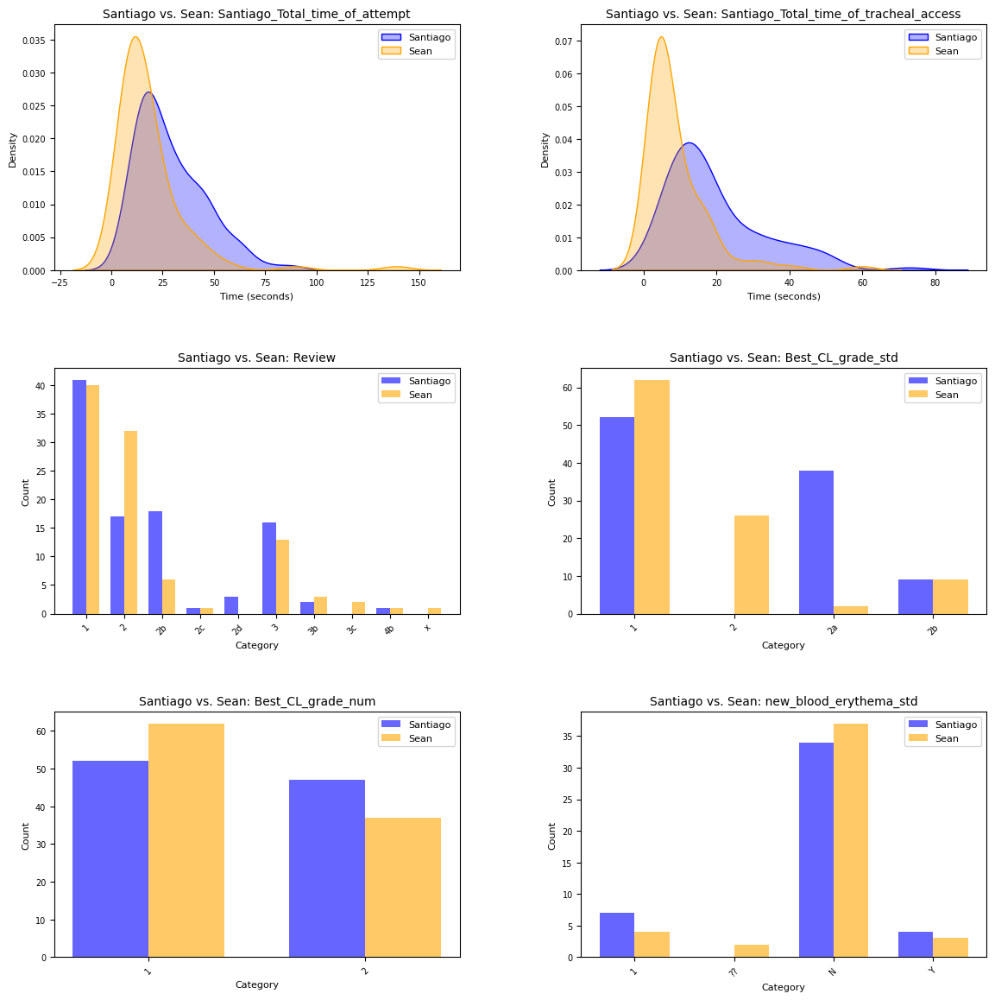

In [ ]:

def visualize_column_pairs(df, column_pairs, output_dir, display=False, fuse_plots=True):
    """
    Create visualizations comparing distributions of paired Sean and Santiago columns.
    Numerical columns: KDE plots; Categorical columns: Bar plots.
    Option to fuse all plots into a single figure or display/save individual plots.
    
    Args:
        df (pandas.DataFrame): Input dataframe
        column_pairs (list): List of tuples (santiago_col, sean_col, plot_type)
        output_dir (str): Directory to save plots
        display (bool): If True, display figures in Jupyter Notebook
        fuse_plots (bool): If True, combine all plots into a single figure; else, individual smaller plots
    
    Returns:
        None (saves plots as PNG files and optionally displays figures)
    """
    # Ensure output directory exists
    os.makedirs(output_dir, exist_ok=True)
    
    if fuse_plots:
        # Create a single figure with 3x2 subplots
        fig, axes = plt.subplots(3, 2, figsize=(12, 12))
        axes = axes.flatten()  # Flatten for easier iteration
        
        for idx, (santiago_col, sean_col, plot_type) in enumerate(column_pairs):
            ax = axes[idx]
            
            if plot_type == 'kde':
                # KDE plot for numerical columns
                santiago_data = df[santiago_col].dropna()
                sean_data = df[sean_col].dropna()
                
                sns.kdeplot(data=santiago_data, label='Santiago', color='blue', fill=True, alpha=0.3, ax=ax)
                sns.kdeplot(data=sean_data, label='Sean', color='orange', fill=True, alpha=0.3, ax=ax)
                
                ax.set_title(f'Santiago vs. Sean: {santiago_col.replace("_std", "").replace("_num", "")}', fontsize=10)
                ax.set_xlabel('Time (seconds)', fontsize=8)
                ax.set_ylabel('Density', fontsize=8)
                ax.legend(fontsize=8)
                ax.tick_params(axis='both', labelsize=7)
            
            elif plot_type == 'bar':
                # Bar plot for categorical columns
                santiago_counts = df[santiago_col].value_counts().sort_index()
                sean_counts = df[sean_col].value_counts().sort_index()
                
                all_categories = sorted(set(santiago_counts.index).union(set(sean_counts.index)))
                santiago_values = [santiago_counts.get(cat, 0) for cat in all_categories]
                sean_values = [sean_counts.get(cat, 0) for cat in all_categories]
                
                bar_width = 0.35
                x = range(len(all_categories))
                
                ax.bar([i - bar_width/2 for i in x], santiago_values, bar_width, label='Santiago', color='blue', alpha=0.6)
                ax.bar([i + bar_width/2 for i in x], sean_values, bar_width, label='Sean', color='orange', alpha=0.6)
                
                ax.set_title(f'Santiago vs. Sean: {santiago_col.replace("Santiago_", "")}', fontsize=10)
                ax.set_xlabel('Category', fontsize=8)
                ax.set_ylabel('Count', fontsize=8)
                ax.set_xticks(x)
                ax.set_xticklabels(all_categories, rotation=45, fontsize=7)
                ax.legend(fontsize=8)
                ax.tick_params(axis='both', labelsize=7)
        
        # Adjust layout for fused figure
        plt.tight_layout()
        plt.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05, wspace=0.3, hspace=0.4)
        
        # Save fused figure
        fused_filename = 'all_column_pairs_comparison.png'
        plt.savefig(os.path.join(output_dir, fused_filename), bbox_inches='tight')
        
        # Display fused figure in Jupyter if requested
        if display:
            plt.show()
        
        plt.close()
    
    # Always save individual plots
    for santiago_col, sean_col, plot_type in column_pairs:
        # Create individual figure with smaller size
        plt.figure(figsize=(8, 4) if display else (10, 6))
        
        if plot_type == 'kde':
            santiago_data = df[santiago_col].dropna()
            sean_data = df[sean_col].dropna()
            
            sns.kdeplot(data=santiago_data, label='Santiago', color='blue', fill=True, alpha=0.3)
            sns.kdeplot(data=sean_data, label='Sean', color='orange', fill=True, alpha=0.3)
            
            plt.title(f'Santiago vs. Sean: {santiago_col.replace("_std", "").replace("_num", "")}')
            plt.xlabel('Time (seconds)')
            plt.ylabel('Density')
            plt.legend()
        
        elif plot_type == 'bar':
            santiago_counts = df[santiago_col].value_counts().sort_index()
            sean_counts = df[sean_col].value_counts().sort_index()
            
            all_categories = sorted(set(santiago_counts.index).union(set(sean_counts.index)))
            santiago_values = [santiago_counts.get(cat, 0) for cat in all_categories]
            sean_values = [sean_counts.get(cat, 0) for cat in all_categories]
            
            bar_width = 0.35
            x = range(len(all_categories))
            
            plt.bar([i - bar_width/2 for i in x], santiago_values, bar_width, label='Santiago', color='blue', alpha=0.6)
            plt.bar([i + bar_width/2 for i in x], sean_values, bar_width, label='Sean', color='orange', alpha=0.6)
            
            plt.title(f'Santiago vs. Sean: {santiago_col.replace("Santiago_", "")}')
            plt.xlabel('Category')
            plt.ylabel('Count')
            plt.xticks(x, all_categories, rotation=45)
            plt.legend()
        
        # Adjust layout and save individual plot
        plt.tight_layout()
        base_name = santiago_col.replace('Santiago_', '')
        filename = f"{base_name}_comparison.png"
        plt.savefig(os.path.join(output_dir, filename))
        
        # Display individual plot in Jupyter if requested and not fusing
        if display and not fuse_plots:
            plt.show()
        
        plt.close()

# Example usage in Jupyter Notebook:
column_pairs = [
    ('Santiago_Total_time_of_attempt_std', 'Sean_Total_time_of_attempt_std', 'kde'),
    ('Santiago_Total_time_of_tracheal_access_std', 'Sean_Total_time_of_tracheal_access_std', 'kde'),
    ('Santiago_Review', 'Sean_Review', 'bar'),
    ('Santiago_Best_CL_grade_std', 'Sean_Best_CL_grade_std', 'bar'),
    ('Santiago_Best_CL_grade_num', 'Sean_Best_CL_grade_num', 'bar'),
    ('Santiago_new_blood_erythema_std', 'Sean_new_blood_erythema_std', 'bar')
]

output_dir = '/data/mskscratch/users/ghoyer/Precision_Air/notebooks/figures4'

# video_df = pd.read_csv('your_data.csv')  # Load your dataframe
visualize_column_pairs(video_df, column_pairs, output_dir, display=True, fuse_plots=True)

### compare distributions of video before and after processing pipeline (trimming of residual frames):


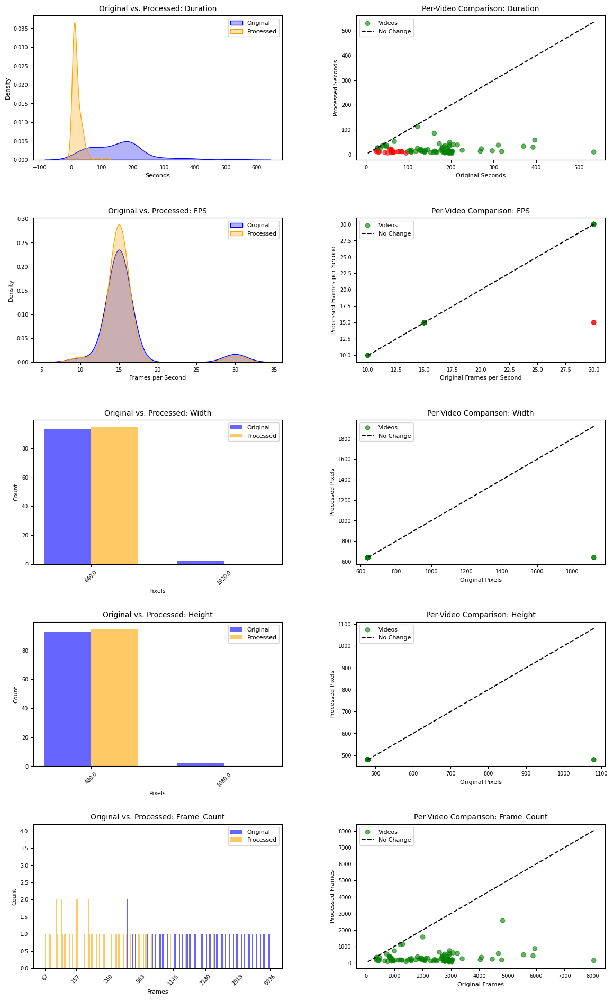

In [ ]:
def visualize_video_metadata_changes(df, column_pairs, output_dir, change_threshold=0.01, display=False):
    """
    Visualize changes in distributions between original and processed video metadata.
    Generate KDE/bar plots for general distributions and scatter plots for per-video changes.
    Option to display a fused figure in Jupyter Notebook with reduced x-axis ticks for Frame_Count.
    
    Args:
        df (pandas.DataFrame): Input dataframe with Video_ID, original, and processed columns
        column_pairs (list): List of tuples (original_col, processed_col, plot_type, unit)
        output_dir (str): Directory to save plots and summary
        change_threshold (float): Threshold for considering a change significant (relative difference)
        display (bool): If True, display fused figure in Jupyter Notebook
    
    Returns:
        pandas.DataFrame: Summary of changes (no change, minor change, significant change)
    """
    # Ensure output directory exists
    os.makedirs(output_dir, exist_ok=True)
    
    # Initialize summary table
    summary_data = {
        'Column': [],
        'No_Change': [],
        'Minor_Change': [],
        'Significant_Change': []
    }
    
    # Create fused figure with 5x2 subplots
    if display:
        fig, axes = plt.subplots(5, 2, figsize=(12, 20))
        axes = axes.flatten()  # Flatten for easier iteration
        subplot_idx = 0
    
    for orig_col, proc_col, plot_type, unit in column_pairs:
        # Filter rows where both values are non-NaN and Processed_video_path is valid
        valid_data = df[df['Processed_video_path'].notna() & df[orig_col].notna() & df[proc_col].notna()]
        
        # Calculate changes
        differences = valid_data[proc_col] - valid_data[orig_col]
        relative_differences = differences / valid_data[orig_col].replace(0, np.nan)
        no_change = (differences.abs() < 1e-6).sum()
        minor_change = ((differences.abs() >= 1e-6) & (relative_differences.abs() < change_threshold)).sum()
        significant_change = (relative_differences.abs() >= change_threshold).sum()
        
        # Update summary
        summary_data['Column'].append(orig_col.replace('_sec', ''))
        summary_data['No_Change'].append(no_change)
        summary_data['Minor_Change'].append(minor_change)
        summary_data['Significant_Change'].append(significant_change)
        
        # 1. General Distribution Plot (Individual)
        plt.figure(figsize=(10, 6))
        if plot_type == 'kde':
            sns.kdeplot(data=valid_data[orig_col], label='Original', color='blue', fill=True, alpha=0.3)
            sns.kdeplot(data=valid_data[proc_col], label='Processed', color='orange', fill=True, alpha=0.3)
            plt.xlabel(unit)
            plt.ylabel('Density')
        elif plot_type == 'bar':
            orig_counts = valid_data[orig_col].value_counts().sort_index()
            proc_counts = valid_data[proc_col].value_counts().sort_index()
            all_values = sorted(set(orig_counts.index).union(set(proc_counts.index)))
            
            orig_values = [orig_counts.get(val, 0) for val in all_values]
            proc_values = [proc_counts.get(val, 0) for val in all_values]
            
            bar_width = 0.35
            x = range(len(all_values))
            plt.bar([i - bar_width/2 for i in x], orig_values, bar_width, label='Original', color='blue', alpha=0.6)
            plt.bar([i + bar_width/2 for i in x], proc_values, bar_width, label='Processed', color='orange', alpha=0.6)
            
            plt.xlabel(unit)
            plt.ylabel('Count')
            if orig_col == 'Frame_Count':
                # Reduce tick frequency for Frame_Count
                if len(all_values) > 10:
                    tick_indices = np.linspace(0, len(all_values)-1, 8, dtype=int)
                    tick_labels = [f'{int(all_values[i])}' for i in tick_indices]
                    plt.xticks(tick_indices, tick_labels, rotation=45)
                else:
                    plt.xticks(x, all_values, rotation=45)
            else:
                plt.xticks(x, all_values, rotation=45)
        
        plt.title(f'Original vs. Processed: {orig_col.replace("_sec", "")}')
        plt.legend(fontsize=10, loc='best')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"{orig_col}_comparison.png"))
        plt.close()
        
        # 2. Per-Video Scatter Plot (Individual)
        plt.figure(figsize=(10, 6))
        colors = ['red' if abs(diff) >= change_threshold * valid_data[orig_col].iloc[i] else 'green' for i, diff in enumerate(relative_differences)]
        
        plt.scatter(valid_data[orig_col], valid_data[proc_col], c=colors, alpha=0.6, label='Videos')
        min_val = min(valid_data[orig_col].min(), valid_data[proc_col].min())
        max_val = max(valid_data[orig_col].max(), valid_data[proc_col].max())
        plt.plot([min_val, max_val], [min_val, max_val], 'k--', label='No Change')
        
        plt.xlabel(f'Original {unit}')
        plt.ylabel(f'Processed {unit}')
        plt.title(f'Per-Video Comparison: {orig_col.replace("_sec", "")}')
        plt.legend(fontsize=10, loc='best')
        plt.tight_layout()
        plt.savefig(os.path.join(output_dir, f"{orig_col}_per_video.png"))
        plt.close()
        
        # Fused Figure (if display=True)
        if display:
            # General Distribution Plot (Subplot)
            ax = axes[subplot_idx]
            if plot_type == 'kde':
                sns.kdeplot(data=valid_data[orig_col], label='Original', color='blue', fill=True, alpha=0.3, ax=ax)
                sns.kdeplot(data=valid_data[proc_col], label='Processed', color='orange', fill=True, alpha=0.3, ax=ax)
                ax.set_xlabel(unit, fontsize=8)
                ax.set_ylabel('Density', fontsize=8)
            elif plot_type == 'bar':
                orig_counts = valid_data[orig_col].value_counts().sort_index()
                proc_counts = valid_data[proc_col].value_counts().sort_index()
                all_values = sorted(set(orig_counts.index).union(set(proc_counts.index)))
                
                orig_values = [orig_counts.get(val, 0) for val in all_values]
                proc_values = [proc_counts.get(val, 0) for val in all_values]
                
                bar_width = 0.35
                x = range(len(all_values))
                ax.bar([i - bar_width/2 for i in x], orig_values, bar_width, label='Original', color='blue', alpha=0.6)
                ax.bar([i + bar_width/2 for i in x], proc_values, bar_width, label='Processed', color='orange', alpha=0.6)
                
                ax.set_xlabel(unit, fontsize=8)
                ax.set_ylabel('Count', fontsize=8)
                if orig_col == 'Frame_Count':
                    # Reduce tick frequency for Frame_Count
                    if len(all_values) > 10:
                        tick_indices = np.linspace(0, len(all_values)-1, 8, dtype=int)
                        tick_labels = [f'{int(all_values[i])}' for i in tick_indices]
                        ax.set_xticks(tick_indices)
                        ax.set_xticklabels(tick_labels, rotation=45, fontsize=7)
                    else:
                        ax.set_xticks(x)
                        ax.set_xticklabels(all_values, rotation=45, fontsize=7)
                else:
                    ax.set_xticks(x)
                    ax.set_xticklabels(all_values, rotation=45, fontsize=7)
            
            ax.set_title(f'Original vs. Processed: {orig_col.replace("_sec", "")}', fontsize=10)
            ax.legend(fontsize=8, loc='best')
            ax.tick_params(axis='both', labelsize=7)
            subplot_idx += 1
            
            # Per-Video Scatter Plot (Subplot)
            ax = axes[subplot_idx]
            colors = ['red' if abs(diff) >= change_threshold * valid_data[orig_col].iloc[i] else 'green' for i, diff in enumerate(relative_differences)]
            
            ax.scatter(valid_data[orig_col], valid_data[proc_col], c=colors, alpha=0.6, label='Videos')
            min_val = min(valid_data[orig_col].min(), valid_data[proc_col].min())
            max_val = max(valid_data[orig_col].max(), valid_data[proc_col].max())
            ax.plot([min_val, max_val], [min_val, max_val], 'k--', label='No Change')
            
            ax.set_xlabel(f'Original {unit}', fontsize=8)
            ax.set_ylabel(f'Processed {unit}', fontsize=8)
            ax.set_title(f'Per-Video Comparison: {orig_col.replace("_sec", "")}', fontsize=10)
            ax.legend(fontsize=8, loc='best')
            ax.tick_params(axis='both', labelsize=7)
            subplot_idx += 1
    
    # Finalize fused figure
    if display:
        plt.tight_layout()
        plt.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05, wspace=0.3, hspace=0.4)
        plt.savefig(os.path.join(output_dir, 'all_metadata_changes_comparison.png'), bbox_inches='tight')
        plt.show()
        plt.close()
    
    # Save summary table
    summary_df = pd.DataFrame(summary_data)
    summary_df.to_csv(os.path.join(output_dir, 'video_metadata_changes_summary.csv'), index=False)
    
    return summary_df

# Example usage in Jupyter Notebook:
column_pairs = [
    ('Duration_sec', 'Processed_Duration_sec', 'kde', 'Seconds'),
    ('FPS', 'Processed_FPS', 'kde', 'Frames per Second'),
    ('Width', 'Processed_Width', 'bar', 'Pixels'),
    ('Height', 'Processed_Height', 'bar', 'Pixels'),
    ('Frame_Count', 'Processed_Frame_Count', 'bar', 'Frames')
]

output_dir = '/data/mskscratch/users/ghoyer/Precision_Air/notebooks/figures5'

# video_df = pd.read_csv('your_data.csv')  # Load your dataframe
summary_df = visualize_video_metadata_changes(video_df, column_pairs, output_dir, display=True)

In [29]:
summary_df

,Column,No_Change,Minor_Change,Significant_Change
0,Duration,0,0,95
1,FPS,93,0,2
2,Width,93,0,2
3,Height,93,0,2
4,Frame_Count,0,0,95


### Visualize videos by classification (Sean Review designations)

Unique Sean_Review values: ['2' '1' '3' '2b' '3b' '3c' '2c' 'x' '4b']


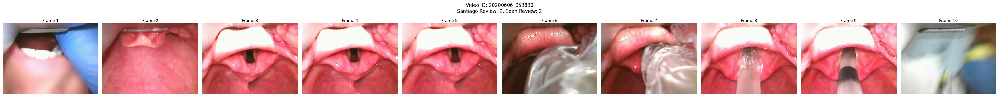

Saved visualization for 20200606_053830 (Sean_Review: 2)


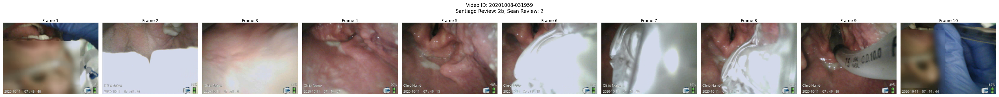

Saved visualization for 20201008-031959 (Sean_Review: 2)


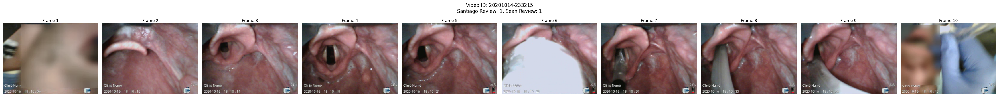

Saved visualization for 20201014-233215 (Sean_Review: 1)


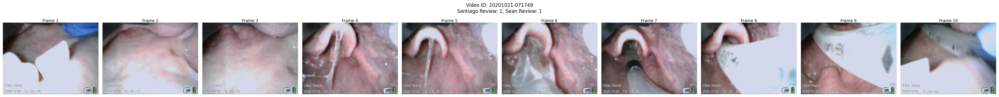

Saved visualization for 20201021-071749 (Sean_Review: 1)


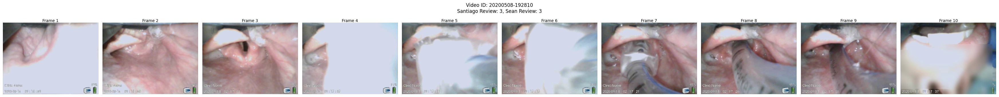

Saved visualization for 20200508-192810 (Sean_Review: 3)


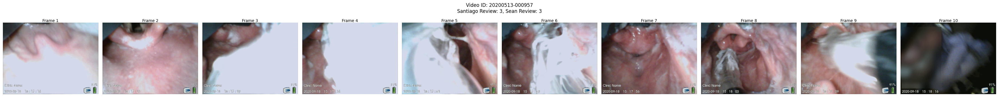

Saved visualization for 20200513-000957 (Sean_Review: 3)


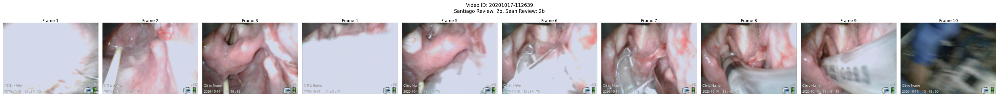

Saved visualization for 20201017-112639 (Sean_Review: 2b)


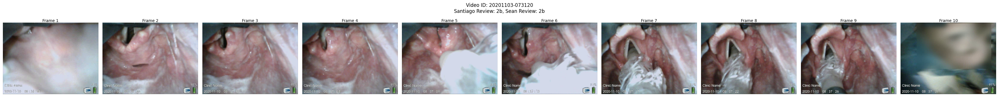

Saved visualization for 20201103-073120 (Sean_Review: 2b)


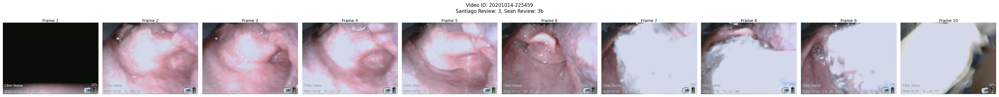

Saved visualization for 20201014-225459 (Sean_Review: 3b)


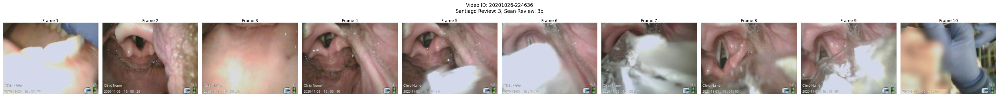

Saved visualization for 20201026-224636 (Sean_Review: 3b)


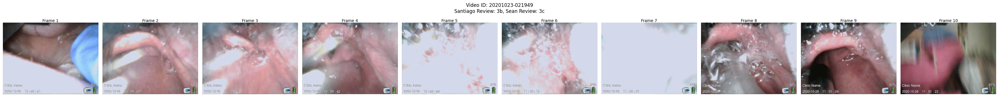

Saved visualization for 20201023-021949 (Sean_Review: 3c)


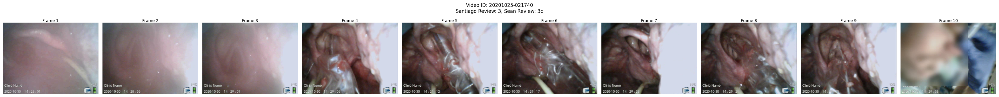

Saved visualization for 20201025-021740 (Sean_Review: 3c)


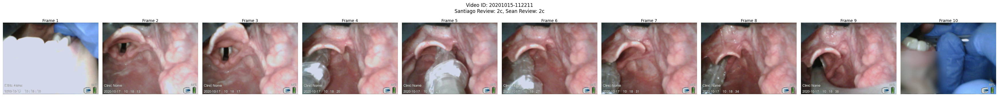

Saved visualization for 20201015-112211 (Sean_Review: 2c)


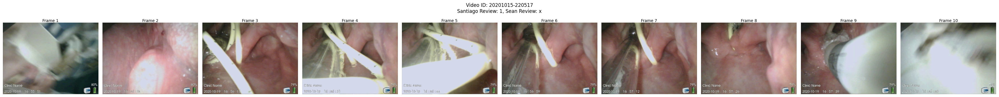

Saved visualization for 20201015-220517 (Sean_Review: x)


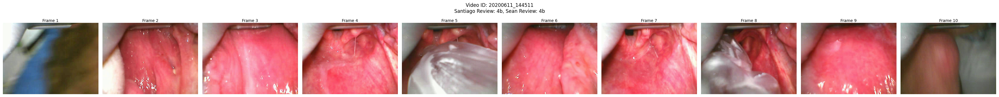

Saved visualization for 20200611_144511 (Sean_Review: 4b)


In [ ]:

def extract_frames(video_path, num_frames=5, frame_size=(320, 240)):
    """
    Extract evenly spaced frames from a video and resize them.
    
    Args:
        video_path (str): Path to the video file
        num_frames (int): Number of frames to extract
        frame_size (tuple): Target size for frames (width, height)
    
    Returns:
        list: List of resized frame images (numpy arrays) or None if failed
    """
    try:
        cap = cv2.VideoCapture(video_path)
        if not cap.isOpened():
            print(f"Failed to open video: {video_path}")
            return None
        
        total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        if total_frames < num_frames:
            print(f"Video {video_path} has too few frames: {total_frames}")
            return None
        
        # Calculate frame indices
        indices = np.linspace(0, total_frames - 1, num_frames, dtype=int)
        frames = []
        
        for idx in indices:
            cap.set(cv2.CAP_PROP_POS_FRAMES, idx)
            ret, frame = cap.read()
            if ret:
                # Convert BGR to RGB for matplotlib
                frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                # Resize frame to consistent size
                frame = cv2.resize(frame, frame_size)
                frames.append(frame)
            else:
                print(f"Failed to read frame {idx} from {video_path}")
                frames.append(None)
        
        cap.release()
        return frames if len(frames) == num_frames else None
    except Exception as e:
        print(f"Error processing video {video_path}: {str(e)}")
        return None

def visualize_processed_videos(df, output_dir, max_videos_per_review=2, num_frames=5, frame_size=(320, 240), display=False):
    """
    Visualize processed videos by selecting 1-2 videos per unique Sean_Review value.
    Display frames with minimal white space and annotations, optionally in Jupyter Notebook.
    
    Args:
        df (pandas.DataFrame): Dataframe with Video_ID, Processed_video_path, Santiago_Review, Sean_Review
        output_dir (str): Directory to save visualization PNGs
        max_videos_per_review (int): Max number of videos to visualize per Sean_Review value
        num_frames (int): Number of frames to extract per video
        frame_size (tuple): Target size for frames (width, height)
        display (bool): If True, display figures in Jupyter Notebook
    
    Returns:
        None (saves PNG files and optionally displays figures)
    """
    # Ensure output directory exists
    os.makedirs(output_dir, exist_ok=True)
    
    # Filter valid rows (non-NaN Processed_video_path and Sean_Review)
    valid_df = df[df['Processed_video_path'].notna() & df['Sean_Review'].notna()]
    
    # Get unique Sean_Review values
    unique_reviews = valid_df['Sean_Review'].unique()
    print(f"Unique Sean_Review values: {unique_reviews}")
    
    # Process each Sean_Review value
    for review in unique_reviews:
        # Select up to max_videos_per_review videos for this review
        review_df = valid_df[valid_df['Sean_Review'] == review]
        selected_videos = review_df.sample(n=min(max_videos_per_review, len(review_df)), random_state=42)
        
        for _, row in selected_videos.iterrows():
            video_id = row['Video_ID']
            video_path = row['Processed_video_path']
            santiago_review = row['Santiago_Review'] if pd.notna(row['Santiago_Review']) else 'N/A'
            sean_review = row['Sean_Review']
            
            # Extract frames
            frames = extract_frames(video_path, num_frames, frame_size)
            if frames is None:
                print(f"Skipping video {video_id} due to frame extraction failure")
                continue
            
            # Create visualization
            # Adjust figure size based on number of frames
            fig_width = num_frames * 3.5  # Scale width with number of frames
            fig_height = 3.5  # Fixed height for single row
            fig, axes = plt.subplots(1, num_frames, figsize=(fig_width, fig_height))
            
            # Add title with larger font size and adjusted position
            fig.suptitle(f"Video ID: {video_id}\nSantiago Review: {santiago_review}, Sean Review: {sean_review}", 
                         fontsize=12, y=0.98)
            
            # Ensure axes is iterable for single frame case
            if num_frames == 1:
                axes = [axes]
            
            for i, (frame, ax) in enumerate(zip(frames, axes)):
                if frame is not None:
                    ax.imshow(frame)
                    ax.set_title(f"Frame {i+1}", fontsize=10, pad=2)
                ax.axis('off')
            
            # Minimize white space
            plt.subplots_adjust(left=0.02, right=0.98, top=0.85, bottom=0.05, wspace=0.05)
            plt.tight_layout()
            
            # Save figure
            safe_review = ''.join(c for c in sean_review if c.isalnum() or c in ['_', '-'])
            filename = f"{video_id}_{safe_review}.png"
            plt.savefig(os.path.join(output_dir, filename), bbox_inches='tight')
            
            # Display in Jupyter Notebook if requested
            if display:
                plt.show()
            
            plt.close()
            print(f"Saved visualization for {video_id} (Sean_Review: {sean_review})")

# Example usage in Jupyter Notebook:
output_dir = '/data/mskscratch/users/ghoyer/Precision_Air/notebooks/video_frames_notebook'

# video_df = pd.read_csv('your_data.csv')  # Load your dataframe
visualize_processed_videos(video_df, output_dir, max_videos_per_review=2, num_frames=10, frame_size=(320, 240), display=True)